# SEM 2D BSE Imaging: Fe fcc Precipitates in bcc Matrix

**Example Data: Steel_FCC_in_BCC_2752**

This is an example notebook to demonstrate angle resolved BSE imaging via signal extraction from raw, saved, EBSD patterns.

A key advantage when using saved raw EBSD patterns is that we can partition the raw signal into a "Kikuchi pattern" and a "background" signal, which will give different types of contrasts. This partition is impossible when using conventional semiconductor diode detection etc. for angle-resolved signal BSE collection. We cannot distinguish between "Kikuchi signal" and "background signal" in the electron current from the diode because the diode signal is a point-signal,  as compared to a full 2D signal which is available on the phosphor screen.

In [1]:
# directory with the HDF5 EBSD pattern file:
data_dir = "../../../xcdskd_reference_data/Steel_FCC_in_BCC/"

# filename of the HDF5 file:
hdf5_filename =  "Steel_FCC_in_BCC_2752.h5"

# Options
output_verbose = False # print explicit filenames

Necessary packages

In [2]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
# ignore divide by Zero
np.seterr(divide='ignore', invalid='ignore')

import time, sys, os
import h5py
import skimage.io 

from aloe.plots import normalizeChannel, make2Dmap, get_vrange
from aloe.plots import plot_image, plot_SEM, plot_SEM_RGB
from aloe.image import arbse
from aloe.image.downsample import downsample
from aloe.image.kikufilter import process_ebsp
from aloe.io.progress import print_progress_line

In [3]:
# load background from different experiment with same detector
background_static_txt_full = np.loadtxt("../data/patterns/static_bam_ef.txt")

# make result dirs and filenames
h5FileNameFull=os.path.abspath(data_dir + hdf5_filename)
h5FileName, h5FileExt = os.path.splitext(h5FileNameFull)
h5FilePath, h5File = os.path.split(h5FileNameFull)
timestr = time.strftime("%Y%m%d-%H%M%S")
h5ResultFile="arBSE_" + hdf5_filename
    

# close HDF5 file if still open
if 'f' in locals():
    f.close()    
f=h5py.File(h5FileName+h5FileExt, "r")

ResultsDir = h5FilePath+"/arBSE_" + timestr + "/" 
CurrentDir = os.getcwd()
#print('Current Directory: '+CurrentDir)
#print('Results Directory: '+ResultsDir)
if not os.path.isdir(ResultsDir):
    os.makedirs(ResultsDir)
os.chdir(ResultsDir)

if output_verbose:
    print('HDF5 full file name: ', h5FileNameFull)
    print('HDF5 File: ', h5FileName+h5FileExt)
    print('HDF5 Path: ', h5FilePath)
    print('Results Directory: ', ResultsDir)
    print('Results File: ', h5ResultFile)

In [4]:
DataGroup="/Scan/EBSD/Data/"
HeaderGroup="/Scan/EBSD/Header/"
Patterns = f[DataGroup+"RawPatterns"]
#StaticBackground=f[DataGroup+"StaticBackground"]
XIndex =   f[DataGroup+"X BEAM"]
YIndex =   f[DataGroup+"Y BEAM"]
MapWidth = f[HeaderGroup+"NCOLS"].value
MapHeight= f[HeaderGroup+"NROWS"].value
PatternHeight=f[HeaderGroup+"PatternHeight"].value
PatternWidth =f[HeaderGroup+"PatternWidth"].value
print('Pattern Height: ', PatternHeight)
print('Pattern Width : ', PatternWidth)
PatternAspect=float(PatternWidth)/float(PatternHeight)
print('Pattern Aspect: '+str(PatternAspect))
print('Map Height: ', MapHeight)
print('Map Width : ', MapWidth)

step_map_microns = f[HeaderGroup+"XSTEP"].value
print('Map Step Size (microns): ', step_map_microns)

Pattern Height:  115
Pattern Width :  160
Pattern Aspect: 1.391304347826087
Map Height:  300
Map Width :  400
Map Step Size (microns):  0.121037425197


Check Optional Pattern Processing

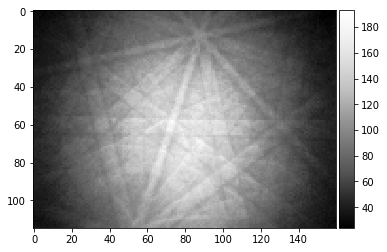

In [5]:
ipattern = 215
raw_pattern=Patterns[ipattern,:,:]
plot_image(raw_pattern)
skimage.io.imsave('pattern_raw_' + str(ipattern) + '.tiff', raw_pattern, plugin='tifffile')

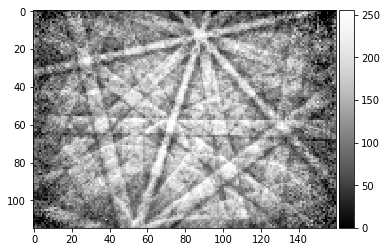

In [6]:
# make processed pattern without static background
processed_pattern = process_ebsp(raw_pattern, binning=1)
plot_image(processed_pattern)
skimage.io.imsave('pattern_processed_' + str(ipattern) + '.tiff', processed_pattern, plugin='tifffile')

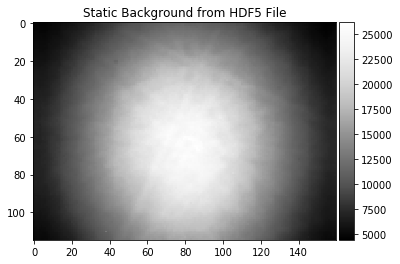

In [7]:
try:
    # get static background from HDF5, cut off first lines to fit to Patterns
    background_static_file = f[HeaderGroup+"StaticBackground"][0,5:,:]
    plot_image(background_static_file, title="Static Background from HDF5 File")
except:
    background_static_file = None

## Static Background from Pattern Average in the Map

We can also approximate a static background from the EBSD map itself; or even use an extra map that was taken explicitly for making a background, e.g. from the sample holder.
For polycrystalline samples with a large enough number of  grains in random orientations, the Kikuchi patterns from all grains will average out when taking the average of all pattern.
For single crystalline samples, or samples with a low number of different orientation present in the map area measured, the average of all patterns will stay contain Kikuchi diffraction features. These features in the static background will tend to produce artififacts when the raw data is processed using the background with diffraction features. 

In [8]:
calc_bg = True
if calc_bg:
    # avoid loading 35GB into RAM if you don't have 35GB RAM...
    # use incremental "updating average"
    # https://math.stackexchange.com/questions/106700/incremental-averageing
    tstart = time.time()
    npatterns = Patterns.shape[0]
    current_average = np.copy(Patterns[0]).astype(np.float64)
    for i in range(1, npatterns):
        current_average = current_average + (Patterns[i] - current_average)/i
        print_progress_line(tstart, i-1, npatterns-1, every=100)

    background_static_from_map = current_average

total points:119999 current:119999 finished -> total calculation time :    0.4 min 


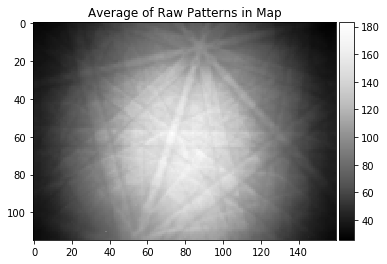

In [9]:
plot_image(background_static_from_map, title="Average of Raw Patterns in Map")

Because we have an bcc-fcc orientation relationship between all the grains in this map, the pattern average still shows all the features which are common to both the bcc parent grain and the fcc inclusions.

(115, 160)
[[ 41.187  41.367  41.491 ...,  39.766  39.829  40.037]
 [ 41.283  41.374  41.392 ...,  39.608  39.749  39.836]
 [ 41.607  42.042  41.783 ...,  40.158  40.186  40.333]
 ..., 
 [ 36.24   37.008  37.093 ...,  39.125  38.512  38.229]
 [ 36.347  36.62   36.757 ...,  38.399  38.03   37.787]
 [ 35.654  36.221  36.438 ...,  38.408  37.231  37.011]]


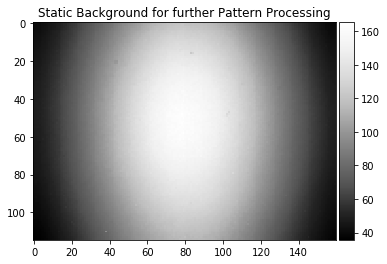

In [10]:
# assign static background from file
background_static = background_static_txt_full[5:,:]
print(background_static.shape)
print(background_static)
plot_image(background_static, title="Static Background for further Pattern Processing")

In [11]:
#skimage.io.imsave('background_static.tiff', background_static, plugin='tifffile') # this is 16bit only
np.savetxt('background_static.txt', background_static)

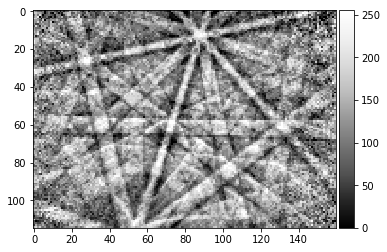

In [12]:
# note the CCD halves and static background dust, hot pixels
processed_pattern = process_ebsp(raw_pattern, static_background=background_static, binning=1)
plot_image(processed_pattern)
skimage.io.imsave('pattern_processed_static_' + str(ipattern) + '.tiff', processed_pattern, plugin='tifffile')

Specification of Image Pre-Processing Functions

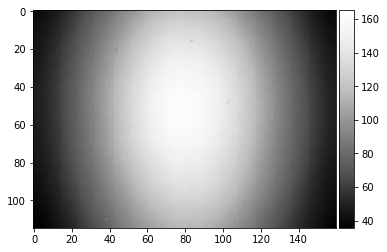

(115, 160)


In [13]:
prebinning=1
background_static_binned = downsample(background_static, prebinning)

def pipeline_process(pattern, prebinning=1, kikuchi=False):
    if prebinning>1:
        pattern = downsample(pattern, prebinning)
    if kikuchi:
        return process_ebsp(pattern, static_background=background_static_binned, binning=1)
    else:
        return pattern
    
def process_kikuchi(pattern):
    return pipeline_process(pattern, prebinning=prebinning, kikuchi=True)

def process_bin(pattern):
    return pipeline_process(pattern, prebinning=prebinning, kikuchi=False)

plot_image(background_static_binned)
print(background_static_binned.shape)

vBSE Arrays

We convert the raw pattern into a 7x7 array of vBSE sensor intensities.

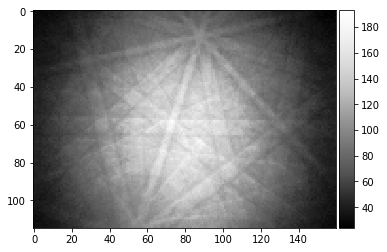

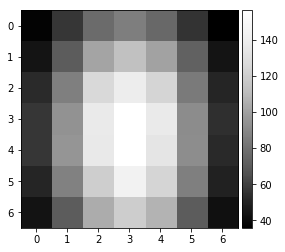

In [14]:
pattern = pipeline_process(Patterns[1000], kikuchi=False)
vbse = arbse.rebin_array(pattern)
plot_image(pattern)
plot_image(vbse)

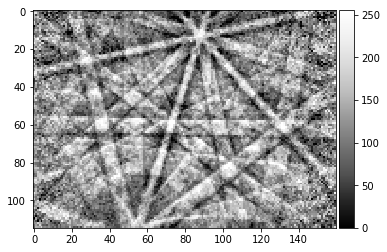

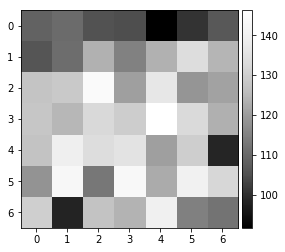

In [15]:
pattern = process_kikuchi(Patterns[1000])
vkiku = arbse.rebin_array(pattern)
plot_image(pattern)
plot_image(vkiku)

## vBSE Detector Signals: Calculation & Saving

This should take a few minutes, depending on your computer and file access speed.

### Virtual BSE Imaging

Imaging the raw intensity in the respective area of the 2D detector (e.g. phosphor screen). Neglects gnomonic projection effect on intensities.

In [16]:
# calculate the vBSE signals in 7x7 array
vbse_array = arbse.make_vbse_array(Patterns)

# make vBSE map of the total screen intensity
bse_total = np.sum(np.sum(vbse_array[:,:,:], axis=1), axis=1)
bse_map = make2Dmap(bse_total, XIndex, YIndex, MapHeight, MapWidth)

total points:120000 current:120000 finished -> total calculation time :    0.7 min 


In [17]:
# save the results in the h5ResultFile
print(h5ResultFile)
with h5py.File(h5ResultFile, 'a') as h5f:
    h5f.create_dataset('vbse', data=vbse_array)
    h5f.create_dataset('/maps/bse_total', data=bse_map)

arBSE_Steel_FCC_in_BCC_2752.h5


### Virtual Orientation Imaging via Kikuchi Pattern Signals

If we process the raw images to obtain only the Kikuchi pattern, we have a modified 2D intensity which can be expected to show increased sensitivity to orientation effects (i.e. changes related to the Kikuchi bands). In a more advanced approach, we could select, for example, specific Kikuchi bands or zone axes to extract imaging signals.

In [18]:
# calculate the vKikuchi signals from processed raw data
vkiku_array = arbse.make_vbse_array(Patterns, process=process_kikuchi)

# make vBSE map of the total screen intensity
kiku_total = np.sum(np.sum(vkiku_array[:,:,:], axis=1), axis=1)
kiku_map = make2Dmap(kiku_total, XIndex, YIndex, MapHeight, MapWidth)

total points:120000 current:120000 finished -> total calculation time :    6.9 min 


In [19]:
# save the results in an extra hdf5 
print(h5ResultFile)
with h5py.File(h5ResultFile, 'a') as h5f:
    h5f.create_dataset('vkiku', data=vkiku_array)
    h5f.create_dataset('/maps/kiku_total', data=kiku_map)

arBSE_Steel_FCC_in_BCC_2752.h5


## vBSE Signals: Plotting

### Total Signal on Screen

Total sum of the 7x7 arrays, for the raw pattern and the Kikuchi pattern at each map point:

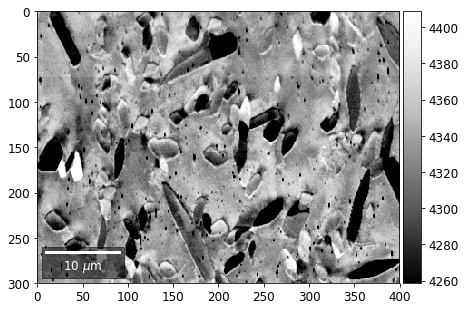

In [20]:
with h5py.File(h5ResultFile, 'r') as h5f:
    bse = h5f['/maps/bse_total']
    plot_SEM(bse, cmap='Greys_r', microns=step_map_microns)

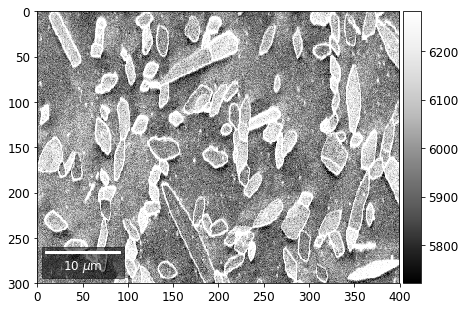

In [21]:
with h5py.File(h5ResultFile, 'r') as h5f:
    kiku = h5f['/maps/kiku_total']
    plot_SEM(kiku, cmap='Greys_r', microns=step_map_microns)

### Intensity in Rows and Columns of the vBSE array

We can calculate additional images from the vBSE data set of 7x7 ROIs derived from the original patterns.
As a first example, we plot the intensities of each of the 7 rows and then of each of the 7 columns: 

#### Rows

Range of Values:  [413.22316568814273, 753.16897562400345]


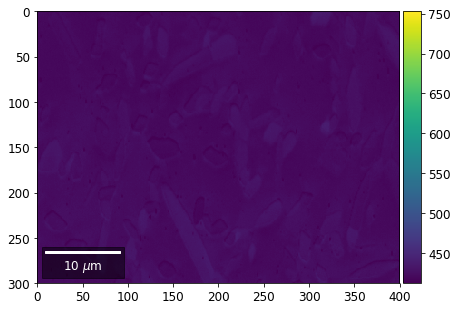

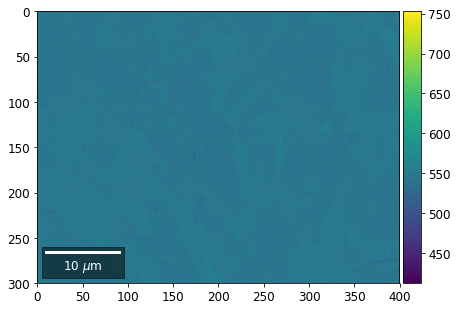

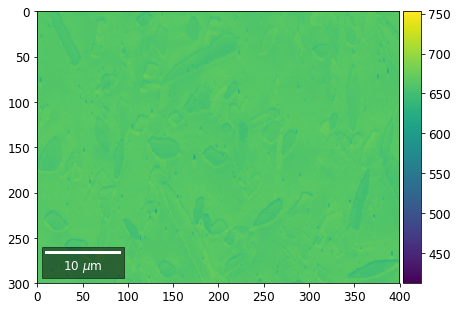

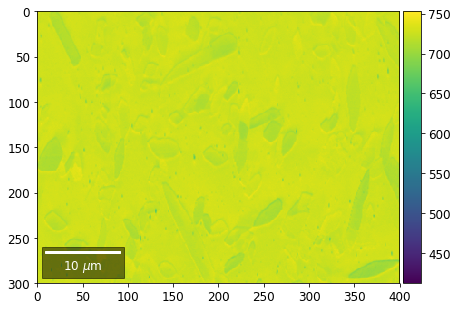

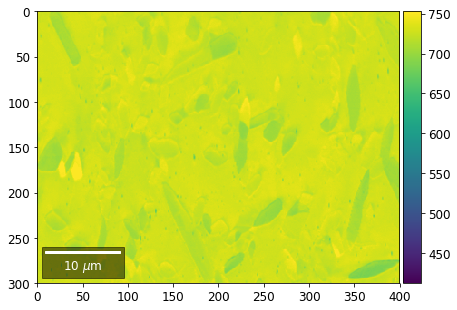

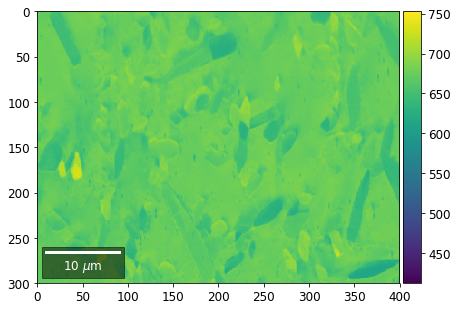

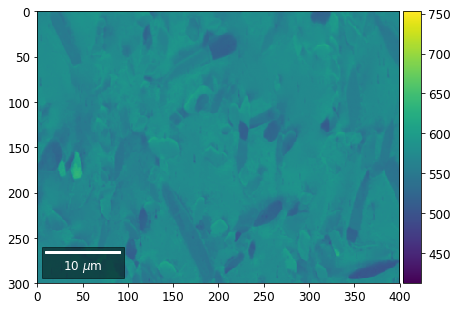

In [22]:
with h5py.File(h5ResultFile, 'r') as h5f:
    vFSD= h5f['vbse']
    
    # signal: sum of row 
    vmin=40000000
    vmax=0

    bse_rows = []

    # (1) get full range for all images
    for row in range(7):
        signal = np.sum(vFSD[:,row,:], axis=1) #/vFSD[:,row+drow,0]
        signal_map = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)
        minv, maxv = get_vrange(signal, stretch=3.0)
        if (minv<vmin):
            vmin=minv
        if (maxv>vmax):
            vmax=maxv    

    # (2) make plots with same range for comparisons of absolute BSE values
    vrange=[vmin, vmax]
    print('Range of Values: ', vrange)
    #vrange=None
    for row in range(7):
        signal = np.sum(vFSD[:,row,:], axis=1) #/vFSD[:,row+drow,0]
        signal_map = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)
        bse_rows.append(signal_map)
        plot_SEM(signal_map, vrange=vrange, filename='vFSD_row_absolute_'+str(row),
                 rot180=True, microns=step_map_microns)

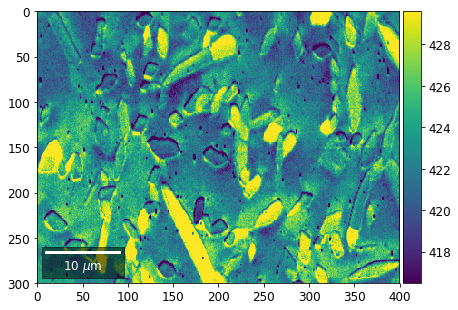

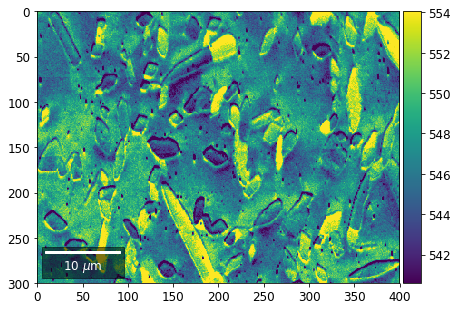

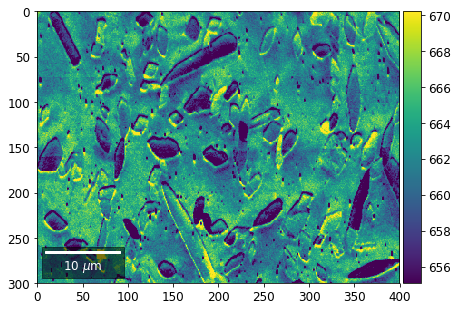

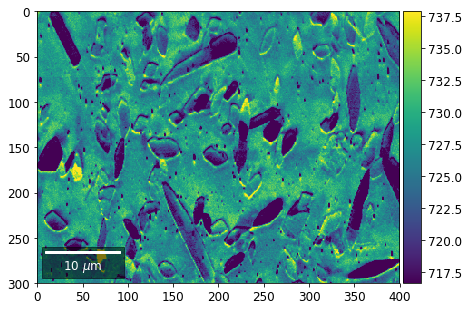

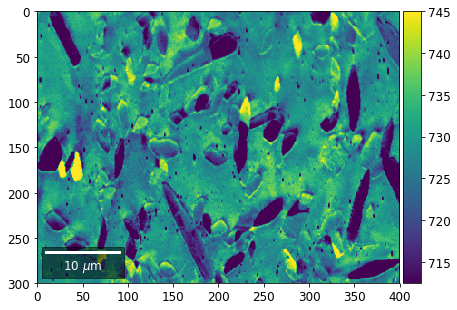

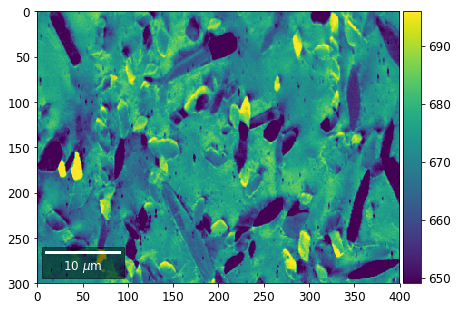

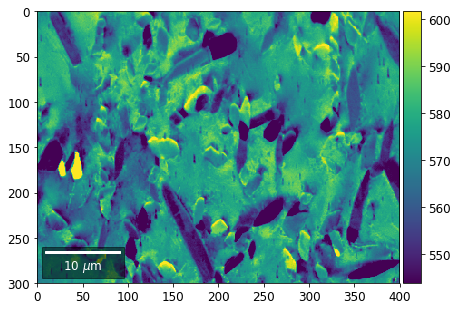

In [23]:
with h5py.File(h5ResultFile, 'r') as h5f:
    vFSD= h5f['vbse']
    # (3) make plots with  individual ranges for better contrast
    vrange=None
    for row in range(7):
        signal = np.sum(vFSD[:,row,:], axis=1) #/vFSD[:,row+drow,0]
        signal_map = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)
        bse_rows.append(signal_map)
        plot_SEM(signal_map, vrange=vrange, filename='vFSD_row_individual_'+str(row),
                 rot180=True, microns=step_map_microns)

#### Columns

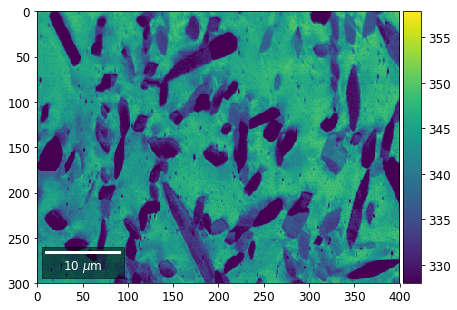

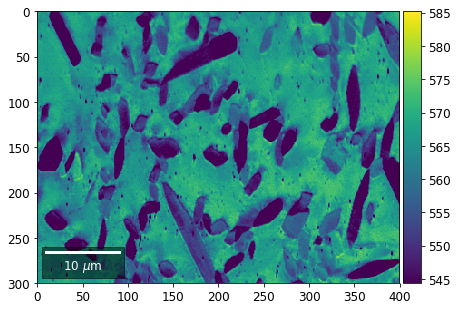

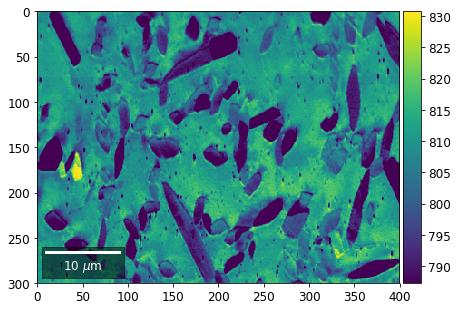

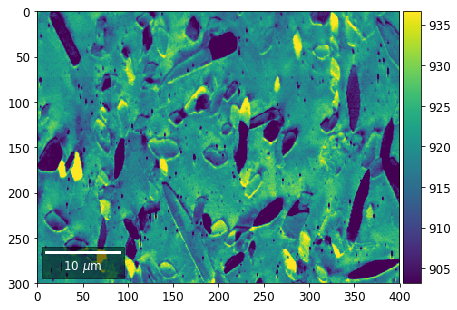

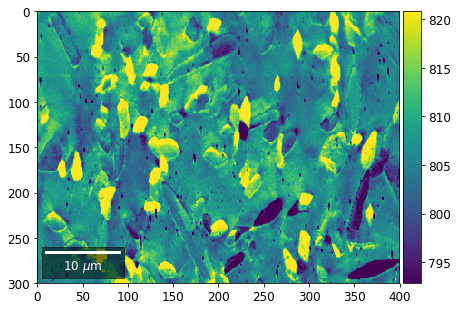

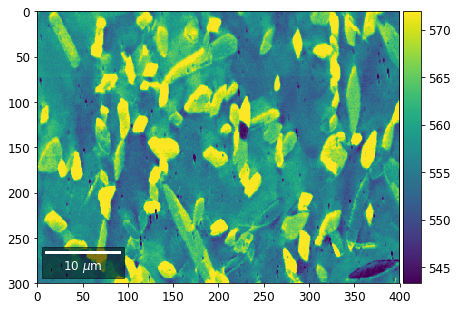

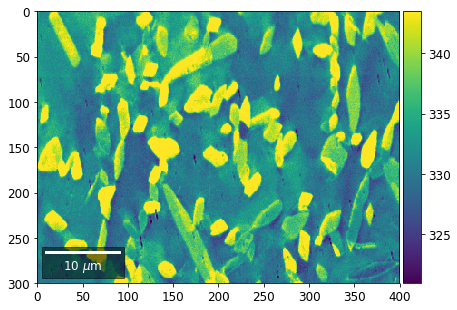

In [24]:
with h5py.File(h5ResultFile, 'r') as h5f:
    vFSD= h5f['vbse']
    # signal: sum of column
    vmin=400000
    vmax=0

    bse_cols = []

    # (1) get full range for all images
    for col in range(7):
        signal = np.sum(vFSD[:,:,col], axis=1) #/vFSD[:,row+drow,0]
        signal_map = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)
        minv, maxv = get_vrange(signal)
        if (minv<vmin):
            vmin=minv
        if (maxv>vmax):
            vmax=maxv    

    # (2) make plots with same range for comparisons of absolute BSE values
    #vrange=[vmin, vmax]
    vrange=None # no fixed scale
    for col in range(7):
        signal = np.sum(vFSD[:,:,col], axis=1) #/vFSD[:,row+drow,0]
        signal_map = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)
        bse_cols.append(signal_map)
        plot_SEM(signal_map, vrange=vrange, filename='vFSD_col_'+str(col),
                 rot180=True, microns=step_map_microns)

### vBSE Color Imaging

We can also form color images by assigning red, green, and blue channels to the left, middle, and right vBSE sensors of a row: 

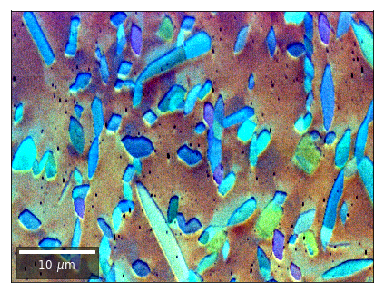

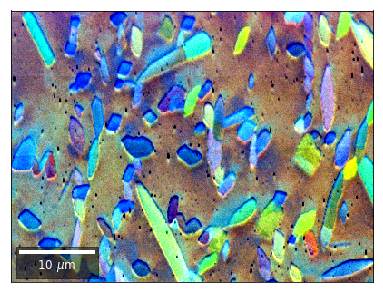

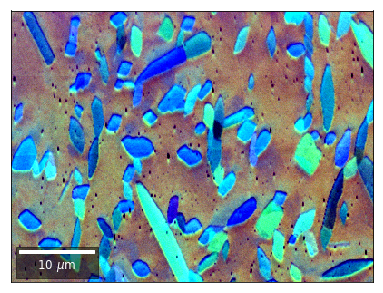

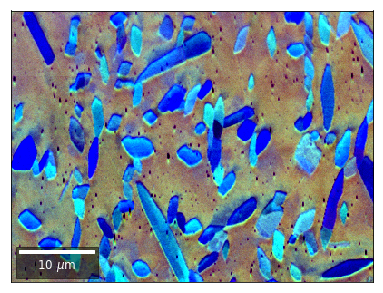

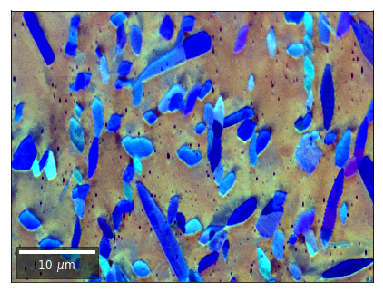

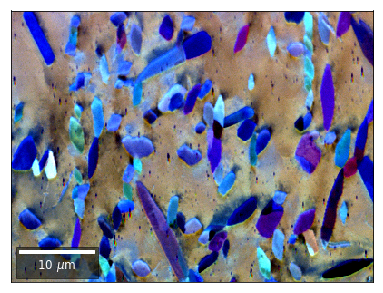

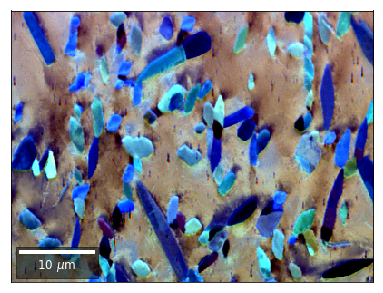

In [25]:
with h5py.File(h5ResultFile, 'r') as h5f:
    vFSD= h5f['vbse']# rgb direct
    rgb_direct = []

    for row in range(7):
        signal = vFSD[:,row,0]
        red = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        signal = vFSD[:,row,3]
        green = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        signal = vFSD[:,row,6]
        blue = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        rgb=plot_SEM_RGB(red, green, blue, MapHeight, MapWidth, 
                         filename='vFSD_RGB_row_'+str(row),
                         rot180=False, microns=step_map_microns,
                         add_bright=0, contrast=0.8)

        rgb_direct.append(rgb)

Differential color signals can be formed by calculating the relative changes to the ROI in the previous row:

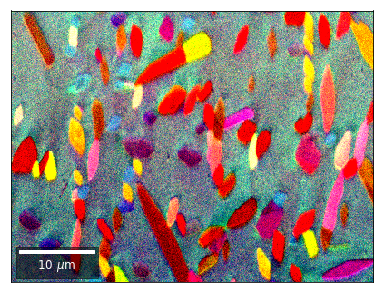

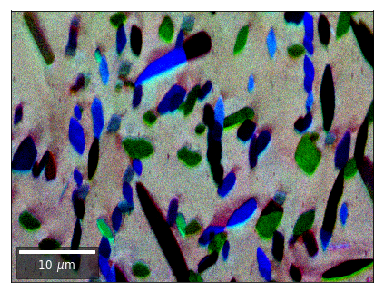

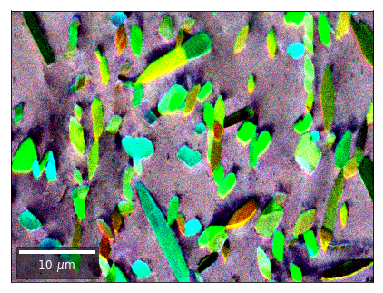

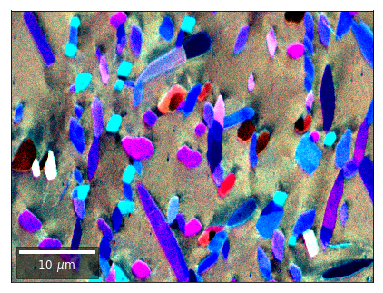

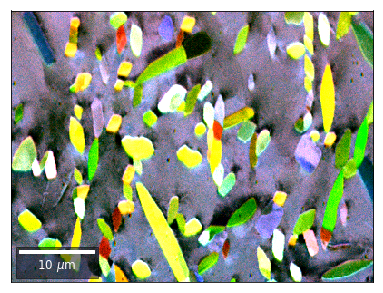

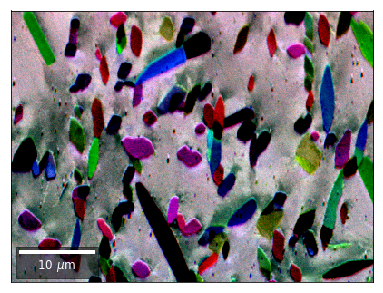

In [26]:
with h5py.File(h5ResultFile, 'r') as h5f:
    vFSD= h5f['vbse']# rgb direct# relative change to previous row
    for row in range(1,7):
        drow = -1
        signal = vFSD[:,row,0]/vFSD[:,row+drow,0]
        red = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        signal = vFSD[:,row,2]/vFSD[:,row+drow,2]
        green = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        signal = vFSD[:,row,4]/vFSD[:,row+drow,4]
        blue = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        rgb=plot_SEM_RGB(red, green, blue, MapHeight, MapWidth, 
                         filename='vFSD_RGB_drow_'+str(row),
                         microns=step_map_microns,
                         rot180=False, add_bright=0, contrast=1.2)

### Kikuchi vBSE Imaging

#### Kikuchi Pattern Array ROI as RGB

Not possible with simple BSE diodes!!!

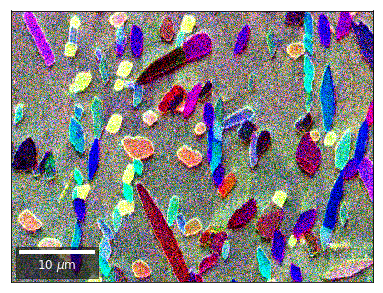

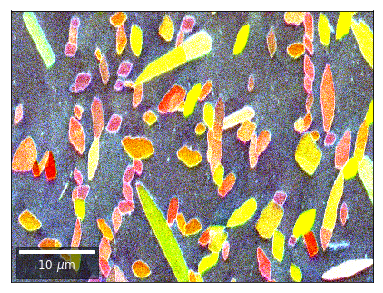

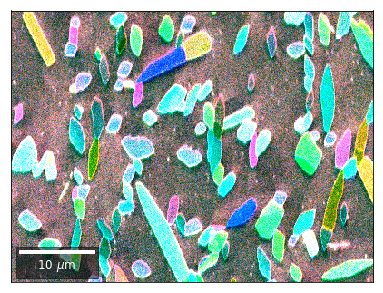

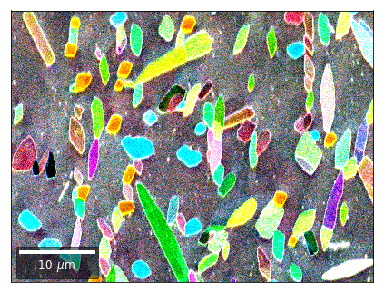

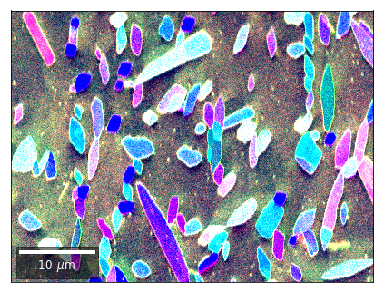

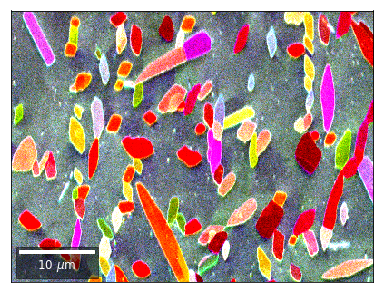

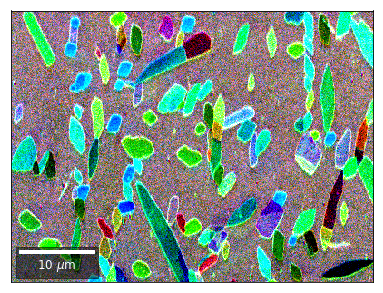

In [27]:
with h5py.File(h5ResultFile, 'r') as h5f:
    vFSD= h5f['vkiku']   

    # rgb direct
    rgb_direct = []

    for row in range(7):
        signal = vFSD[:,row,0]
        red = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        signal = vFSD[:,row,3]
        green = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        signal = vFSD[:,row,6]
        blue = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        rgb=plot_SEM_RGB(red, green, blue, MapHeight, MapWidth, 
                         filename='vKiku_RGB_row_'+str(row),
                         rot180=False, microns=step_map_microns,
                         add_bright=0, contrast=1.2)

        rgb_direct.append(rgb)

#### Differential Kikuchi Imaging

We determine the relative change between Kikuchi Array ROIs and use them as RGB values.
The normalization to a reference ROI reduces the noise that is purely due to the variation of the background and the background processing on the complete pattern.

The colors represent orientation changes via the corresponding changes in ROIs of the Kikuchi patterns and the 7x7 array.

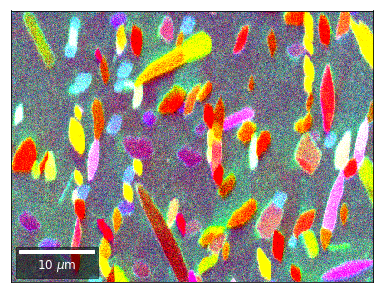

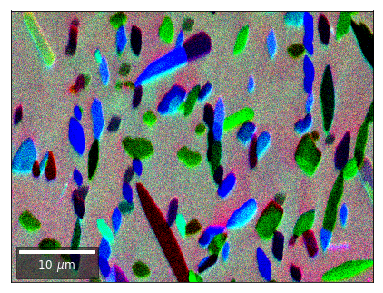

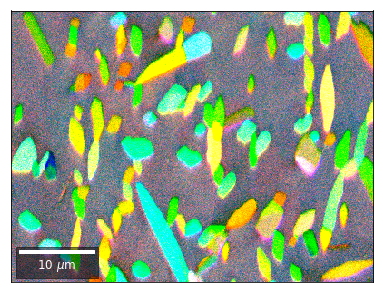

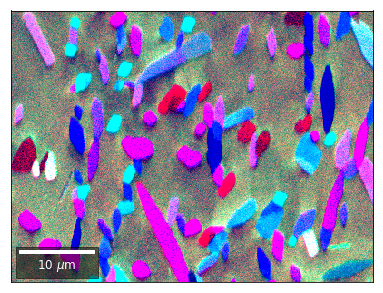

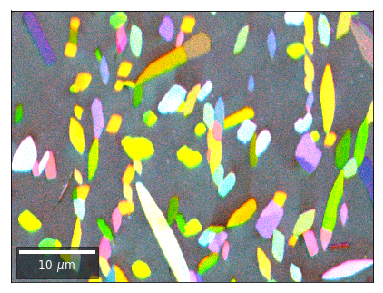

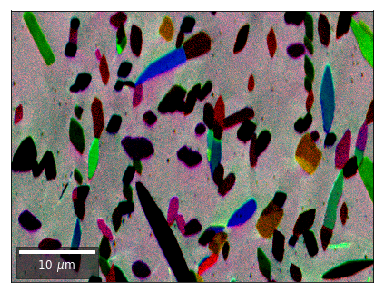

In [28]:
with h5py.File(h5ResultFile, 'r') as h5f:
    vFSD= h5f['vkiku'] 
    # relative change to previous row
    for row in range(1,7):
        drow = -1
        signal = vFSD[:,row,0]/vFSD[:,row+drow,0]
        red = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        signal = vFSD[:,row,2]/vFSD[:,row+drow,2]
        green = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        signal = vFSD[:,row,4]/vFSD[:,row+drow,4]
        blue = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        rgb=plot_SEM_RGB(red, green, blue, MapHeight, MapWidth, 
                         filename='vKiku_RGB_drow_'+str(row),
                         microns=step_map_microns,
                         rot180=False, add_bright=0, contrast=1.2)

## Center of Mass Imaging 

We can interpret the 2D image intensity as a mass density on a plane. The statistical moments of the density distribution (mean, variance, ...) can be used as signal sources. 
In the example below, we use the image center of mass as a signal source.

### COM of Raw Patterns

In [29]:
# calculate the center-of-mass for each pattern, use binning for speed
COMxp, COMyp = arbse.calc_COM_px(Patterns, process=process_bin)

total points:120000 current:120000 finished -> total calculation time :    0.6 min 


In [30]:
# save the results in h5ResultFile 
print(h5ResultFile)
with h5py.File(h5ResultFile, 'a') as h5f:
    h5f.create_dataset('/COM/COMxp_vbse', data=COMxp)
    h5f.create_dataset('/COM/COMyp_vbse', data=COMyp)   

arBSE_Steel_FCC_in_BCC_2752.h5


### COM of Kikuchi Patterns

This should be seen with caution, as the background removal process is never perfect and will tend to leave some residual intensity, so that the Kikuchi COM is correlated with the raw pattern COM (which is dominated by the smooth background intensity).

In [31]:
COMxp, COMyp = arbse.calc_COM_px(Patterns, process=process_kikuchi)

total points:120000 current:120000 finished -> total calculation time :    4.8 min 


In [32]:
# append to current h5ResultFile
print(h5ResultFile)
with h5py.File(h5ResultFile, 'a') as h5f:
    h5f.create_dataset('/COM/COMxp_kiku', data=COMxp)
    h5f.create_dataset('/COM/COMyp_kiku', data=COMyp)   

arBSE_Steel_FCC_in_BCC_2752.h5


First, we calculate where the COMs are in x,y in pixels in the patterns:

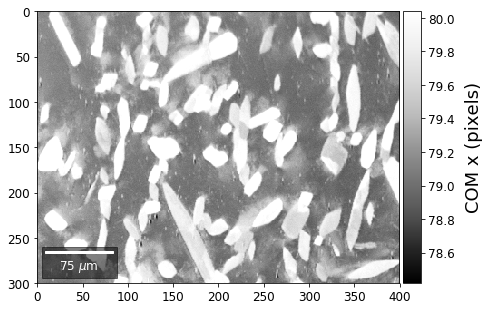

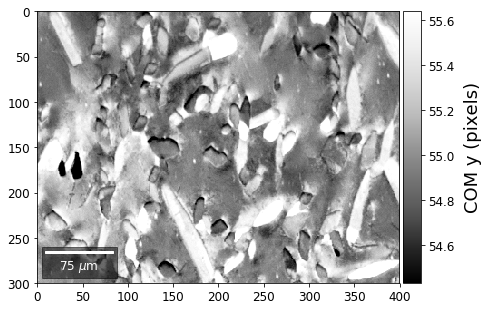

In [33]:
with h5py.File(h5ResultFile, 'r') as h5f:
    COMxp = h5f['/COM/COMxp_vbse']
    COMyp = h5f['/COM/COMyp_vbse']
    
    comx_map0=make2Dmap(COMxp[:],XIndex,YIndex,MapHeight,MapWidth)
    comy_map0=make2Dmap(COMyp[:],XIndex,YIndex,MapHeight,MapWidth)

    plot_SEM(comx_map0, colorbarlabel='COM x (pixels)', cmap='Greys_r')
    plot_SEM(comy_map0, colorbarlabel='COM y (pixels)', cmap='Greys_r')

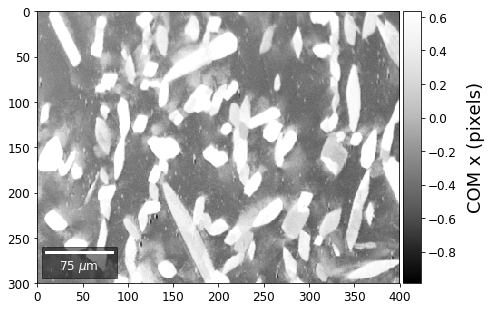

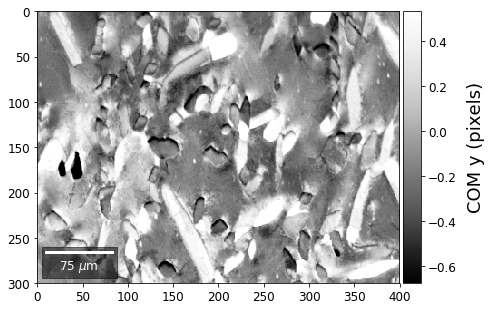

In [34]:
with h5py.File(h5ResultFile, 'r') as h5f:
    COMxp = h5f['/COM/COMxp_vbse']
    COMyp = h5f['/COM/COMyp_vbse']
    
    meanx=np.mean(COMxp)
    meany=np.mean(COMyp)

    comx_map=make2Dmap(COMxp[:]-meanx,XIndex,YIndex,MapHeight,MapWidth)
    comy_map=make2Dmap(COMyp[:]-meany,XIndex,YIndex,MapHeight,MapWidth)

    plot_SEM(comx_map, colorbarlabel='COM x (pixels)', filename='comx', cmap='Greys_r')
    plot_SEM(comy_map, colorbarlabel='COM y (pixels)', filename='comy', cmap='Greys_r')

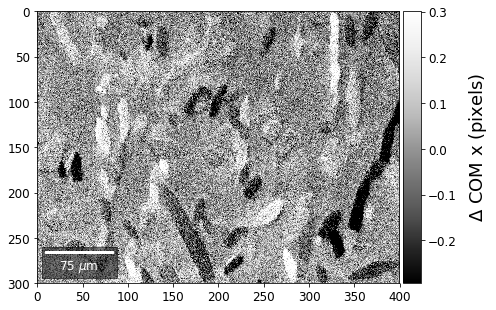

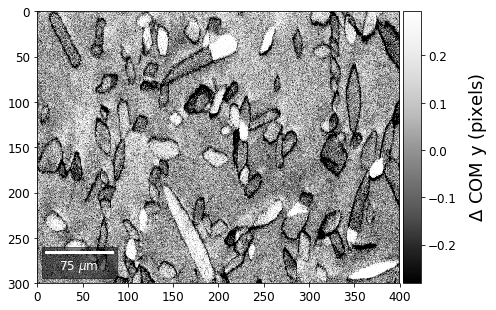

In [35]:
with h5py.File(h5ResultFile, 'r') as h5f:
    COMxp = h5f['/COM/COMxp_kiku']
    COMyp = h5f['/COM/COMyp_kiku']
    meanx = np.mean(COMxp)
    meany = np.mean(COMyp)

    comx_map = make2Dmap(COMxp[:] - meanx, XIndex, YIndex, MapHeight, MapWidth)
    comy_map = make2Dmap(COMyp[:] - meany, XIndex, YIndex, MapHeight, MapWidth)

    plot_SEM(comx_map, colorbarlabel='$\Delta$ COM x (pixels)', filename='comx_kiku', cmap='Greys_r')
    plot_SEM(comy_map, colorbarlabel='$\Delta$ COM y (pixels)', filename='comy_kiku', cmap='Greys_r')

## Fourier Transform Based Imaging

With the help of the Fast Fourier Transform (FFT), we can extract information on spatial frequencies (wave vectors) from an image. This can be used to derive imaging signals which are based on ranges of specific wave vectors present in the Kikuchi pattern. 

In the example shown below, we determine the intensity in the four quadrants of the FFT spectrum magnitude. 
The points corresponding to the low spatial frequencies (large spatial extensions) are removed to suppress the influence of the background signal.

In [36]:
from scipy import fftpack

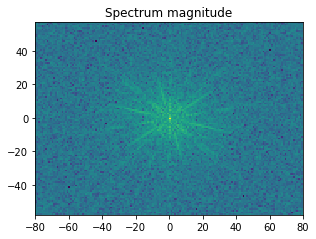

In [37]:
image = process_kikuchi(Patterns[0])
M, N = image.shape
F = fftpack.fftn(image)

F_magnitude = np.abs(F)
F_magnitude = fftpack.fftshift(F_magnitude)


magnitude = np.log(1 + F_magnitude)

f, ax = plt.subplots(figsize=(4.8, 4.8))

ax.imshow(magnitude, cmap='viridis',
          extent=(-N // 2, N // 2, -M // 2, M // 2))
ax.set_title('Spectrum magnitude');

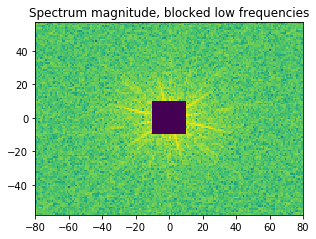

In [38]:
# Set block around center of spectrum to zero
K = 10
F_magnitude[M // 2 - K: M // 2 + K, N // 2 - K: N // 2 + K] = 0

magnitude = np.log(1 + F_magnitude)

f, ax = plt.subplots(figsize=(4.8, 4.8))

ax.imshow(magnitude, cmap='viridis',
          extent=(-N // 2, N // 2, -M // 2, M // 2))
ax.set_title('Spectrum magnitude, blocked low frequencies');

In [39]:
def get_fft_sector_mask(image, isector, rmin=0.1, rmax=0.4,
                        width_rad=np.pi/8, offset_rad=0.0):
    """
    get specified 45 deg sector mask from fft magnitude spectrum of image
    """
    F = fftpack.fftn(image)
    F_magnitude = np.abs(F)
    F_magnitude = fftpack.fftshift(F_magnitude)
    
    phi_start = (isector % 4) * np.pi/4 + offset_rad
    phi_end   = phi_start + width_rad 
    sector_mask = np.ones_like(F_magnitude)
    M, N = F_magnitude.shape
    M2 = M // 2
    N2 = N // 2
    for ix in range(N):
        for iy in range(M):
            rx = ix-N2
            ry = iy-M2
            phi = np.arctan2(ry, rx)
            r = np.sqrt(rx**2 + ry**2)
            if (phi>phi_start) and (phi<phi_end) and (r<= M2 * rmax ) and (r>=M2*rmin) :
                sector_mask[iy,ix] = 0
    
    #profile_quality_map = np.ma.MaskedArray(profile_quality_map, mask=calcmask)
    return sector_mask

def get_fft_sector(spectrum2d, mask):
    return np.ma.MaskedArray(spectrum2d, mask=mask)

In [40]:
mask_0 = get_fft_sector_mask(Patterns[0], 0)
mask_1 = get_fft_sector_mask(Patterns[0], 1)
mask_2 = get_fft_sector_mask(Patterns[0], 2)
mask_3 = get_fft_sector_mask(Patterns[0], 3)

sec_0 = get_fft_sector(F_magnitude, mask_0)
sec_1 = get_fft_sector(F_magnitude, mask_1)
sec_2 = get_fft_sector(F_magnitude, mask_2)
sec_3 = get_fft_sector(F_magnitude, mask_3)

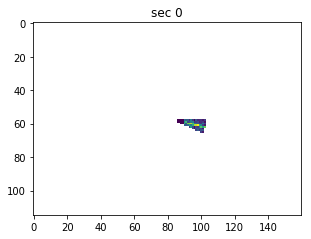

In [41]:
f, ax = plt.subplots(figsize=(4.8, 4.8))
ax.imshow(sec_0, cmap='viridis',)
ax.set_title('sec 0');

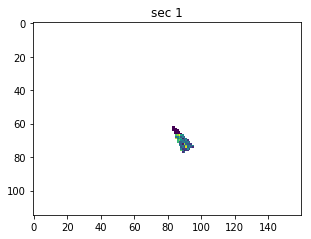

In [42]:
f, ax = plt.subplots(figsize=(4.8, 4.8))
ax.imshow(sec_1, cmap='viridis',)
ax.set_title('sec 1');

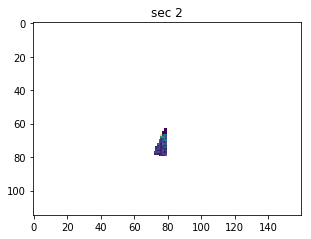

In [43]:
f, ax = plt.subplots(figsize=(4.8, 4.8))
ax.imshow(sec_2, cmap='viridis',)
ax.set_title('sec 2');

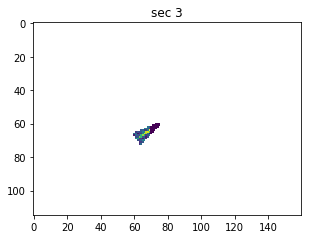

In [44]:
f, ax = plt.subplots(figsize=(4.8, 4.8))
ax.imshow(sec_3, cmap='viridis',)
ax.set_title('sec 3');

In [45]:
def secfft(image, masks, K=5):
    """
    calculate FFT magnitude sectors
    
    remove +/- K points in center (low spatial frequencies)
    limit to +/- W points away from center (low pass, avoid noise at higher frequencies)
    
    """
    M, N = image.shape
    mask_0, mask_1, mask_2, mask_3 = masks
    
    F = fftpack.fftn(image)

    F_magnitude = np.abs(F)
    F_magnitude = fftpack.fftshift(F_magnitude)
    #F_magnitude = np.log(1 + F_magnitude)
    
    # Set block +/-K around center of spectrum to zero
    F_magnitude[M // 2 - K: M // 2 + K, N // 2 - K: N // 2 + K] = 0

    sec_0 = get_fft_sector(F_magnitude, mask_0)
    sec_1 = get_fft_sector(F_magnitude, mask_1)
    sec_2 = get_fft_sector(F_magnitude, mask_2)
    sec_3 = get_fft_sector(F_magnitude, mask_3)
    
    s0 = np.sum(sec_0)
    s1 = np.sum(sec_1)
    s2 = np.sum(sec_2)
    s3 = np.sum(sec_3)
    
    return np.array([s0, s1, s2, s3])



def calc_secfft(patterns, process=None, K=4):
    """
    calc magnitude sum in FFT quadrants of image
    "process" is an optional image pre-processing function
    """
    npatterns = patterns.shape[0]
    fft_sec_magnitudes = np.zeros((npatterns, 4))
    
    mask_0 = get_fft_sector_mask(patterns[0], 0)
    mask_1 = get_fft_sector_mask(patterns[0], 1)
    mask_2 = get_fft_sector_mask(patterns[0], 2)
    mask_3 = get_fft_sector_mask(patterns[0], 3)
    
    masks = (mask_0, mask_1, mask_2, mask_3)
    
    tstart = time.time()
    for i in range(npatterns):
        
        # get current pattern
        if process is None:
            fft_sec_magnitudes[i,:] = secfft(patterns[i,:,:], masks, K=K)
        else:
            fft_sec_magnitudes[i,:] = secfft(process(patterns[i,:,:]), masks, K=K)

        print_progress_line(tstart, i, npatterns)       

    return fft_sec_magnitudes

In [46]:
secfftmag =  calc_secfft(Patterns, process=process_kikuchi)

total points:120000 current:120000 finished -> total calculation time :    7.2 min 


In [47]:
# append to current h5ResultFile
print(h5ResultFile)
with h5py.File(h5ResultFile, 'a') as h5f:
    h5f.create_dataset('/fft_sectors', data=secfftmag)

arBSE_Steel_FCC_in_BCC_2752.h5


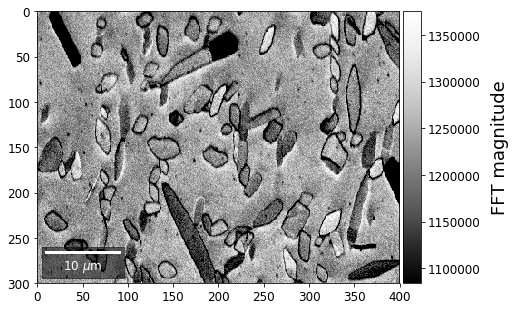

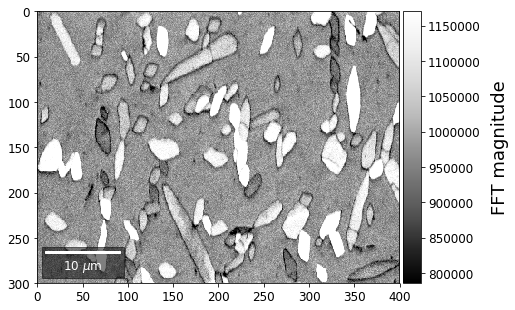

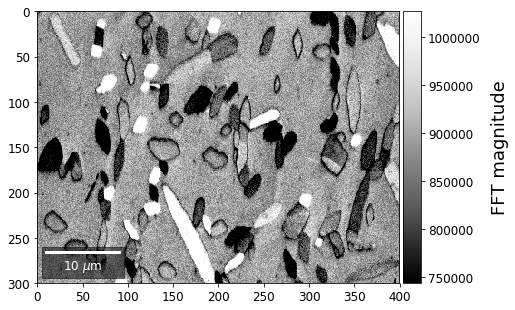

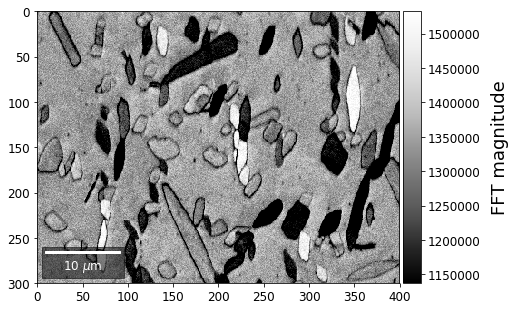

In [48]:
with h5py.File(h5ResultFile, 'r') as h5f:
    secfftmag = np.copy(h5f['fft_sectors'])
    for q, sector in enumerate(secfftmag.T):
        signal_map = make2Dmap(sector,XIndex,YIndex,MapHeight,MapWidth)
        plot_SEM(signal_map, vrange=None, cmap='Greys_r', 
                 colorbarlabel='FFT magnitude', microns=step_map_microns,
                 filename='secFFT_'+str(q))

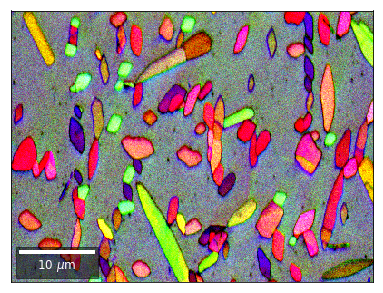

In [49]:
with h5py.File(h5ResultFile, 'r') as h5f:
    secfftmag = h5f['fft_sectors']
    
    signal = secfftmag[:,1] 
    red = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

    signal = secfftmag[:,2] 
    green = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

    signal = secfftmag[:,0] 
    blue = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

    rgb=plot_SEM_RGB(red, green, blue, MapHeight, MapWidth, 
                         filename='fft_sectors_RGB', microns=step_map_microns,
                         rot180=False, add_bright=0, contrast=1.0)

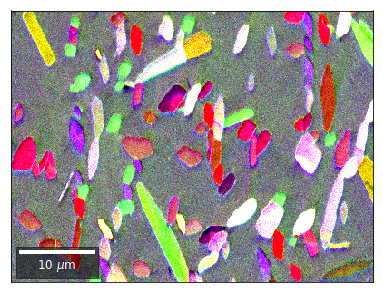

In [50]:
# normalize to reference sector
with h5py.File(h5ResultFile, 'r') as h5f:
    secfftmag = h5f['fft_sectors']
    
    ref_signal = secfftmag[:,3]

    signal = secfftmag[:,1] / ref_signal
    red = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

    signal = secfftmag[:,2] / ref_signal
    green = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

    signal = secfftmag[:,0] / ref_signal
    blue = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

    rgb=plot_SEM_RGB(red, green, blue, MapHeight, MapWidth, 
                         filename='fft_sectors_rel_RGB', microns=step_map_microns,
                         rot180=False, add_bright=0, contrast=1.0)

## Radon Transform Imaging

(...without pattern indexing)

In [51]:
from skimage.transform import radon
from aloe.image.nxcc import mask_pattern_disk

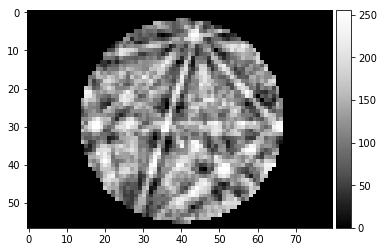

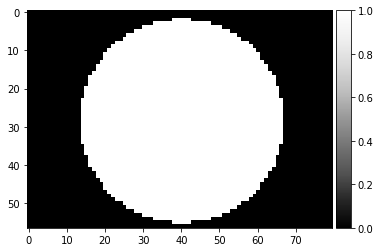

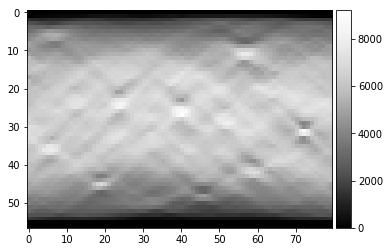

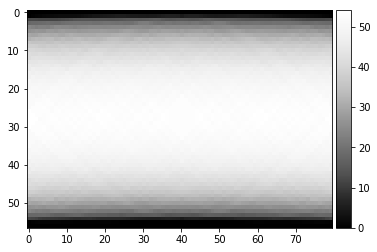

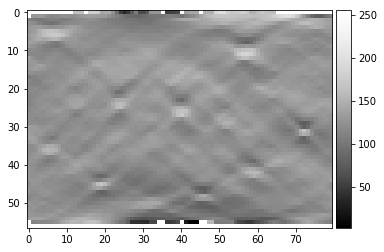

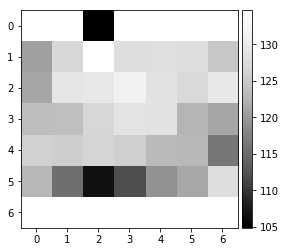

In [52]:
prebinning_radon = 2 # downsample patterns before Radon (speed)

background_static_radon = downsample(background_static, prebinning_radon) # need downsampled background for processing

# angles for Radon (constant for each pattern)
theta = np.linspace(0., 180., max(image.shape) // 2, endpoint=False)

def calc_radon(image, theta, sinogram_reference=None):
    """ calculate radon vbse array """
    
    sinogram = radon(image, theta=theta, circle=True)

    if sinogram_reference is not None:
        sino = sinogram / sinogram_reference
    else:
        sino = sinogram
    
    mean_radon = np.nanmean(sino)
    sino = (sino - mean_radon)**2
    
    # clip 2 lines
    return sino[2:-2,:]


def process_kikuchi_radon(pattern):
    return process_ebsp(downsample(pattern, prebinning_radon), static_background=background_static_radon)


def process_radon(pattern):
    processed_pattern = process_ebsp(downsample(pattern, prebinning_radon), static_background=background_static_radon)
    kiku, npix = mask_pattern_disk(processed_pattern, rmax=0.333)
    sino = calc_radon(kiku, theta, sinogram_reference=sinogram_uniform)
    return sino


image, npix = mask_pattern_disk(process_kikuchi_radon(Patterns[0]), rmax=0.333)
image_uniform, npix = mask_pattern_disk(np.ones_like(image), rmax=0.333)

img_height, img_width = image.shape

plot_image(image)
plot_image(image_uniform)

sinogram = radon(image, theta=theta, circle=True)
sinogram_uniform = radon(image_uniform, theta=theta, circle=True)
plot_image(sinogram)
plot_image(sinogram_uniform)

sino = sinogram / sinogram_uniform
sino77=arbse.rebin_array(sino)
plot_image(sino)
plot_image(sino77)


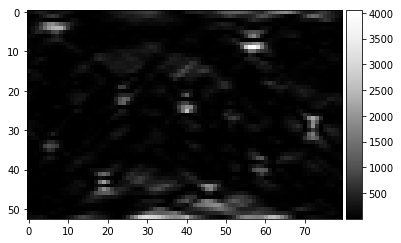

In [53]:
radon_test = process_radon(Patterns[0])
plot_image(radon_test)

Calculate Radon arrays for all patterns:

In [54]:
vbse_radon =  arbse.make_vbse_array(Patterns, process=process_radon)

total points:120000 current:120000 finished -> total calculation time :   35.3 min 


In [55]:
# save to current hdf5 results file 
print(h5ResultFile)
with h5py.File(h5ResultFile, 'a') as h5f:
    h5f.create_dataset('vbse_radon', data=vbse_radon)   

arBSE_Steel_FCC_in_BCC_2752.h5


### Radon 7x7 array, for each row, RGB color from element in column 1, 4, 7

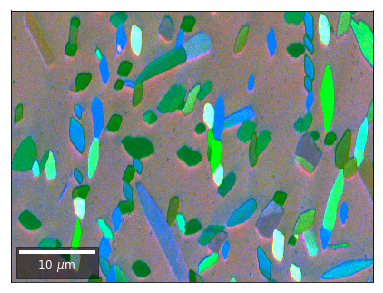

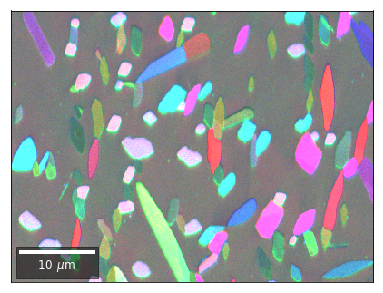

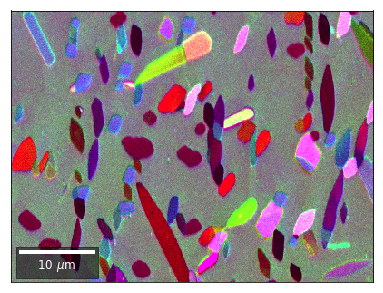

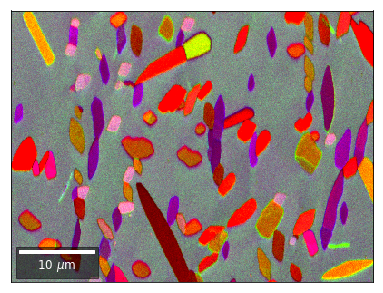

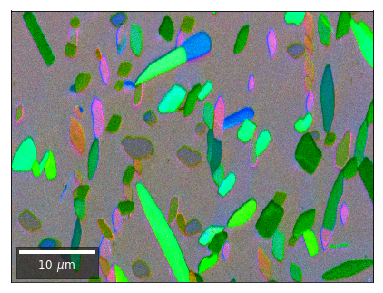

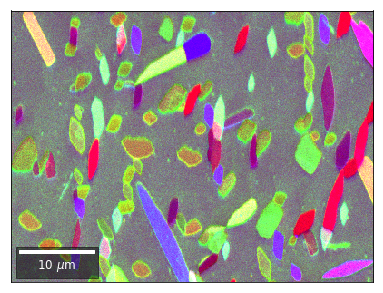

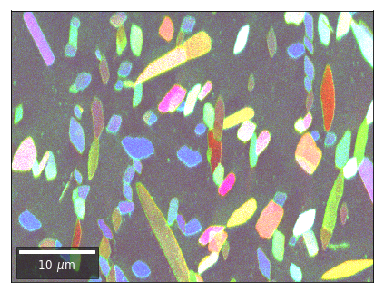

In [56]:
with h5py.File(h5ResultFile, 'r') as h5f:
    vFSD = h5f['vbse_radon']
    # rgb direct
    rgb_direct = []

    for row in range(7):
        signal = vFSD[:,row,0]
        red = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        signal = vFSD[:,row,3]
        green = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        signal = vFSD[:,row,6]
        blue = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        rgb=plot_SEM_RGB(red, green, blue, MapHeight, MapWidth, 
                         filename='vRadon_RGB_'+str(row),
                         rot180=False, microns=step_map_microns,
                         add_bright=0, contrast=0.8)

        rgb_direct.append(rgb)

### Radon 7x7 array: For each row, RGB color signal from CHANGE of elements in column 1, 4, 7 relative to previous row¶

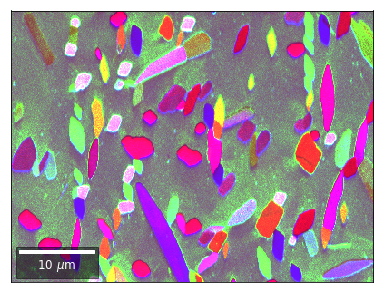

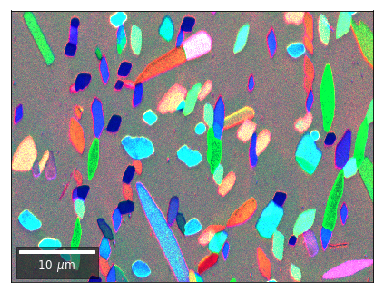

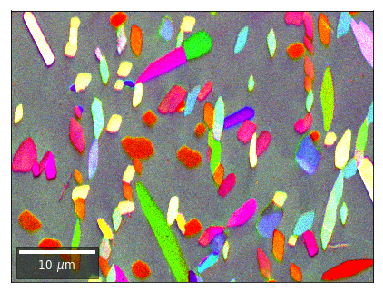

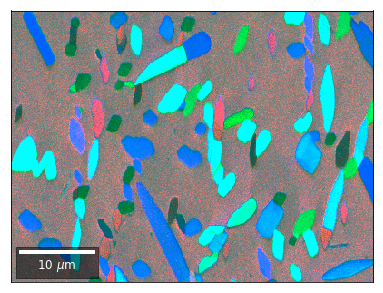

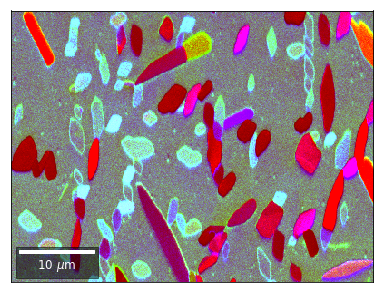

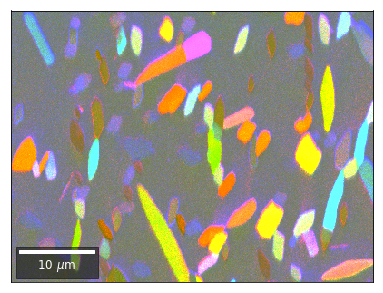

In [57]:
with h5py.File(h5ResultFile, 'r') as h5f:
    vFSD = h5f['vbse_radon']
    # relative change to previous row
    for row in range(1,7):
        drow = -1
        signal = vFSD[:,row,0]/vFSD[:,row+drow,0]
        red = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        signal = vFSD[:,row,2]/vFSD[:,row+drow,2]
        green = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        signal = vFSD[:,row,4]/vFSD[:,row+drow,4]
        blue = make2Dmap(signal,XIndex,YIndex,MapHeight,MapWidth)

        rgb=plot_SEM_RGB(red, green, blue, MapHeight, MapWidth, 
                         filename='vRadon_RGB_drow_'+str(row),
                         microns=step_map_microns,
                         rot180=False, add_bright=0, contrast=1.2)